# Assignment 1 Notebook

# 🧑 **Employee attrition prediction**🧑









# *Exploratory Data Analysis (EDA) and Visualization:*

---



In [ ]:
!pip uninstall ydata_profiling
!pip install ydata_profiling
!pip install plotly

Found existing installation: ydata-profiling 4.6.5
Uninstalling ydata-profiling-4.6.5:
  Would remove:
    /usr/local/bin/pandas_profiling
    /usr/local/bin/ydata_profiling
    /usr/local/lib/python3.10/dist-packages/pandas_profiling/*
    /usr/local/lib/python3.10/dist-packages/ydata_profiling-4.6.5.dist-info/*
    /usr/local/lib/python3.10/dist-packages/ydata_profiling/*
Proceed (Y/n)? Y
  Successfully uninstalled ydata-profiling-4.6.5
  Using cached ydata_profiling-4.6.5-py2.py3-none-any.whl (357 kB)


In [ ]:
import pandas as pd
from ydata_profiling import ProfileReport
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score

In [ ]:
# # Load the dataset
hrdata = pd.read_csv('hr.csv')

In [ ]:
# # Pandas DataFrame functions and insights
print(hrdata.head())

   id  Age     BusinessTravel  DailyRate              Department  \
0   0   36  Travel_Frequently        599  Research & Development   
1   1   35      Travel_Rarely        921                   Sales   
2   2   32      Travel_Rarely        718                   Sales   
3   3   38      Travel_Rarely       1488  Research & Development   
4   4   50      Travel_Rarely       1017  Research & Development   

   DistanceFromHome  Education EducationField  EmployeeCount  \
0                24          3        Medical              1   
1                 8          3          Other              1   
2                26          3      Marketing              1   
3                 2          3        Medical              1   
4                 5          4        Medical              1   

   EnvironmentSatisfaction  ... StandardHours  StockOptionLevel  \
0                        4  ...            80                 1   
1                        1  ...            80                 1   
2    

In [ ]:
# # YData
profile = ProfileReport(hrdata, title="Attrition Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

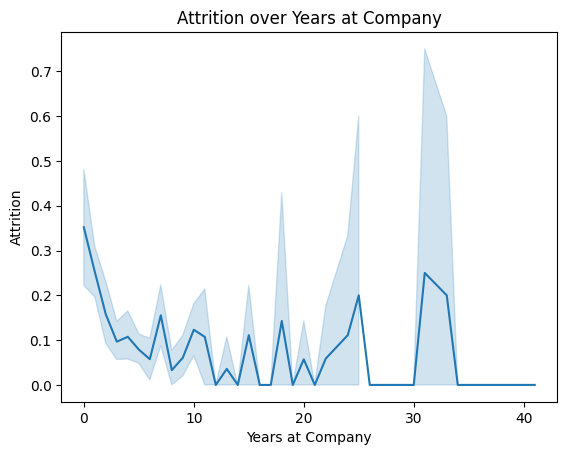

In [ ]:
# Seaborn
# Relationship between Years and Attrition
sns.lineplot(x=hrdata['YearsAtCompany'], y=hrdata['Attrition'])
plt.title("Attrition over Years at Company")
plt.xlabel("Years at Company")
plt.ylabel("Attrition")
plt.show()

In [ ]:
# Plotly
# Scatter Chart
print('Plotly')
sample = hrdata.sample(100)
fig = px.scatter(
  sample, x="MonthlyIncome", y="Attrition"
)
fig.show()

Plotly


# Preprocessing

---



In [ ]:
hrdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1677 entries, 0 to 1676
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   id                        1677 non-null   int64 
 1   Age                       1677 non-null   int64 
 2   BusinessTravel            1677 non-null   object
 3   DailyRate                 1677 non-null   int64 
 4   Department                1677 non-null   object
 5   DistanceFromHome          1677 non-null   int64 
 6   Education                 1677 non-null   int64 
 7   EducationField            1677 non-null   object
 8   EmployeeCount             1677 non-null   int64 
 9   EnvironmentSatisfaction   1677 non-null   int64 
 10  Gender                    1677 non-null   object
 11  HourlyRate                1677 non-null   int64 
 12  JobInvolvement            1677 non-null   int64 
 13  JobLevel                  1677 non-null   int64 
 14  JobRole                 

In [ ]:
hrdata.drop(["EmployeeCount", "id","Over18", "StandardHours"], axis=1, inplace=True)

In [ ]:
# Find null values
hrdata.isnull().sum()

Age                         0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSinceLastPromotion     0
YearsWithCurrManager        0
Attrition                   0
dtype: int64

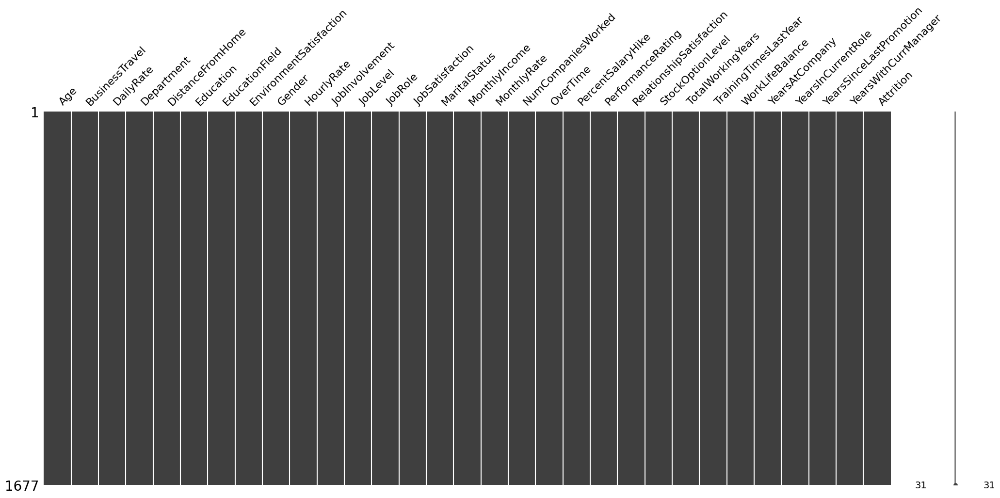

In [ ]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from scipy.stats import zscore

# Visualize null values
import missingno as msno
import matplotlib.pyplot as plt

msno.matrix(hrdata)
plt.show()

In [ ]:
class conf:
    index = 'id'
    target = 'Attrition'
    random = 2023

    load_original = True
np.random.seed(conf.random)

In [ ]:
num_cols = ["Age", "DailyRate", "DistanceFromHome", "HourlyRate", "MonthlyIncome", "MonthlyRate",
            "HourlyRate", "NumCompaniesWorked", "PercentSalaryHike", "TotalWorkingYears",
            "TrainingTimesLastYear", "YearsAtCompany", "YearsInCurrentRole", "YearsSinceLastPromotion",
            "YearsWithCurrManager"]

In [ ]:
cat_cols = hrdata.drop([conf.target], axis=1).columns.difference(num_cols)

In [ ]:
from sklearn.impute import KNNImputer
from sklearn.preprocessing import RobustScaler

cat_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(sparse=False, handle_unknown='error'))
])

num_transformer = Pipeline(steps=[
    ('imputer', KNNImputer(n_neighbors=5)),
    ('scaler', RobustScaler())
])

full_pip = ColumnTransformer(
    transformers=[
        ('num', num_transformer, num_cols),
        ('cat', cat_transformer, cat_cols)], remainder= 'passthrough')

# Model Construction and Evaluation

---



In [ ]:
X = hrdata.copy()
y = hrdata.Attrition
X = X.drop('Attrition',axis=1)

In [ ]:
x=full_pip.fit_transform(X)

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning:

`sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.



In [ ]:
x_train,x_val,y_train,y_val=train_test_split(x,y,test_size=0.1,random_state=7, shuffle=True)

In [ ]:
RF_model=RandomForestRegressor(n_estimators=78, max_depth=7)
RF_model.fit(x_train,y_train)
y_pred=RF_model.predict(x_val)
roc_auc_score(y_val, y_pred)

0.8493683187560739

# *Citation:*

---


https://jaketae.github.io/study/sklearn-pipeline/

https://www.kaggle.com/competitions/playground-series-s3e3/code




